# Notebook Imports

In [1]:
from sklearn.datasets import load_boston
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

import statsmodels.api as sm
from statsmodels.stats.outliers_influence import variance_inflation_factor

#Gathering Data

In [2]:
boston = load_boston()

In [3]:
type(boston)

sklearn.utils.Bunch

In [4]:
#boston

# Clean and Explor the Data

1) De unde vine datele? / Care este sursa datelor?

2) pot afla o scurta descriere a cea ce este in interiorul baze de date?

3) Cat de mare este baza de date ? Cate puncte sunt in baza de date? Am deaface cu o baza de date mare sau una mica?

4) Cate features are baza de date? pentru fiecare punct din dataset cam cate aspecte sun masurabile. cate randuri? cate coloane? cate caraceristi ?

5) care sunt numele acelor features?

6) care sunt destrierile acestor features?

In [5]:
dir(boston)

['DESCR', 'data', 'feature_names', 'filename', 'target']

In [6]:
print(boston.DESCR)

.. _boston_dataset:

Boston house prices dataset
---------------------------

**Data Set Characteristics:**  

    :Number of Instances: 506 

    :Number of Attributes: 13 numeric/categorical predictive. Median Value (attribute 14) is usually the target.

    :Attribute Information (in order):
        - CRIM     per capita crime rate by town
        - ZN       proportion of residential land zoned for lots over 25,000 sq.ft.
        - INDUS    proportion of non-retail business acres per town
        - CHAS     Charles River dummy variable (= 1 if tract bounds river; 0 otherwise)
        - NOX      nitric oxides concentration (parts per 10 million)
        - RM       average number of rooms per dwelling
        - AGE      proportion of owner-occupied units built prior to 1940
        - DIS      weighted distances to five Boston employment centres
        - RAD      index of accessibility to radial highways
        - TAX      full-value property-tax rate per $10,000
        - PTRATIO  pu

## Data poinst and features

In [7]:
type(boston.data)


numpy.ndarray

In [8]:
#cate puncte, cate features
boston.data.shape

(506, 13)

In [9]:
#Atribut = features sunt reptrezentate in coloane iar fiecare coloana reprezinta un atribut pentru baza de date(datasets)
boston.feature_names

array(['CRIM', 'ZN', 'INDUS', 'CHAS', 'NOX', 'RM', 'AGE', 'DIS', 'RAD',
       'TAX', 'PTRATIO', 'B', 'LSTAT'], dtype='<U7')

In [10]:
#unde este pretul in feature name?
#Actol pret este in 1000
boston.target

array([24. , 21.6, 34.7, 33.4, 36.2, 28.7, 22.9, 27.1, 16.5, 18.9, 15. ,
       18.9, 21.7, 20.4, 18.2, 19.9, 23.1, 17.5, 20.2, 18.2, 13.6, 19.6,
       15.2, 14.5, 15.6, 13.9, 16.6, 14.8, 18.4, 21. , 12.7, 14.5, 13.2,
       13.1, 13.5, 18.9, 20. , 21. , 24.7, 30.8, 34.9, 26.6, 25.3, 24.7,
       21.2, 19.3, 20. , 16.6, 14.4, 19.4, 19.7, 20.5, 25. , 23.4, 18.9,
       35.4, 24.7, 31.6, 23.3, 19.6, 18.7, 16. , 22.2, 25. , 33. , 23.5,
       19.4, 22. , 17.4, 20.9, 24.2, 21.7, 22.8, 23.4, 24.1, 21.4, 20. ,
       20.8, 21.2, 20.3, 28. , 23.9, 24.8, 22.9, 23.9, 26.6, 22.5, 22.2,
       23.6, 28.7, 22.6, 22. , 22.9, 25. , 20.6, 28.4, 21.4, 38.7, 43.8,
       33.2, 27.5, 26.5, 18.6, 19.3, 20.1, 19.5, 19.5, 20.4, 19.8, 19.4,
       21.7, 22.8, 18.8, 18.7, 18.5, 18.3, 21.2, 19.2, 20.4, 19.3, 22. ,
       20.3, 20.5, 17.3, 18.8, 21.4, 15.7, 16.2, 18. , 14.3, 19.2, 19.6,
       23. , 18.4, 15.6, 18.1, 17.4, 17.1, 13.3, 17.8, 14. , 14.4, 13.4,
       15.6, 11.8, 13.8, 15.6, 14.6, 17.8, 15.4, 21

## Data explorare cu Pandas Dataframes

In [11]:
#Creare panda dataframe
data = pd.DataFrame(data=boston.data, columns=boston.feature_names)

#adugam o coloana cu pretul
data['PRICE'] = boston.target

In [12]:
data.head()# the top rows look like this:


,CRIM,ZN,INDUS,CHAS,NOX,RM,AGE,DIS,RAD,TAX,PTRATIO,B,LSTAT,PRICE
0,0.00632,18.0,2.31,0.0,0.538,6.575,65.2,4.0900,1.0,296.0,15.3,396.90,4.98,24.0
1,0.02731,0.0,7.07,0.0,0.469,6.421,78.9,4.9671,2.0,242.0,17.8,396.90,9.14,21.6
2,0.02729,0.0,7.07,0.0,0.469,7.185,61.1,4.9671,2.0,242.0,17.8,392.83,4.03,34.7
3,0.03237,0.0,2.18,0.0,0.458,6.998,45.8,6.0622,3.0,222.0,18.7,394.63,2.94,33.4
4,0.06905,0.0,2.18,0.0,0.458,7.147,54.2,6.0622,3.0,222.0,18.7,396.90,5.33,36.2


In [13]:
data.tail()# Rows at botton of dataframe look like this:


,CRIM,ZN,INDUS,CHAS,NOX,RM,AGE,DIS,RAD,TAX,PTRATIO,B,LSTAT,PRICE
501,0.06263,0.0,11.93,0.0,0.573,6.593,69.1,2.4786,1.0,273.0,21.0,391.99,9.67,22.4
502,0.04527,0.0,11.93,0.0,0.573,6.120,76.7,2.2875,1.0,273.0,21.0,396.90,9.08,20.6
503,0.06076,0.0,11.93,0.0,0.573,6.976,91.0,2.1675,1.0,273.0,21.0,396.90,5.64,23.9
504,0.10959,0.0,11.93,0.0,0.573,6.794,89.3,2.3889,1.0,273.0,21.0,393.45,6.48,22.0
505,0.04741,0.0,11.93,0.0,0.573,6.030,80.8,2.5050,1.0,273.0,21.0,396.90,7.88,11.9


In [14]:
data.count()# ne va arata numarul de randuri. instant = numarul de data points/rows, reprezinta object a dataframe

CRIM       506
ZN         506
INDUS      506
CHAS       506
NOX        506
RM         506
AGE        506
DIS        506
RAD        506
TAX        506
PTRATIO    506
B          506
LSTAT      506
PRICE      506
dtype: int64

## Cleaning data - verifica valorile care lipses

In [15]:
#prima metoda
pd.isnull(data).any()

CRIM       False
ZN         False
INDUS      False
CHAS       False
NOX        False
RM         False
AGE        False
DIS        False
RAD        False
TAX        False
PTRATIO    False
B          False
LSTAT      False
PRICE      False
dtype: bool

In [16]:
# a doua metoda
data.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 506 entries, 0 to 505
Data columns (total 14 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   CRIM     506 non-null    float64
 1   ZN       506 non-null    float64
 2   INDUS    506 non-null    float64
 3   CHAS     506 non-null    float64
 4   NOX      506 non-null    float64
 5   RM       506 non-null    float64
 6   AGE      506 non-null    float64
 7   DIS      506 non-null    float64
 8   RAD      506 non-null    float64
 9   TAX      506 non-null    float64
 10  PTRATIO  506 non-null    float64
 11  B        506 non-null    float64
 12  LSTAT    506 non-null    float64
 13  PRICE    506 non-null    float64
dtypes: float64(14)
memory usage: 55.5 KB


## Data Vizualarizare
Distributia datelor

Outliers in data

Histogram ne arata nr de instante in baza de data care are o anumita valoare

## Visualizare data -Histgrams , Distibutions and Bar Charts

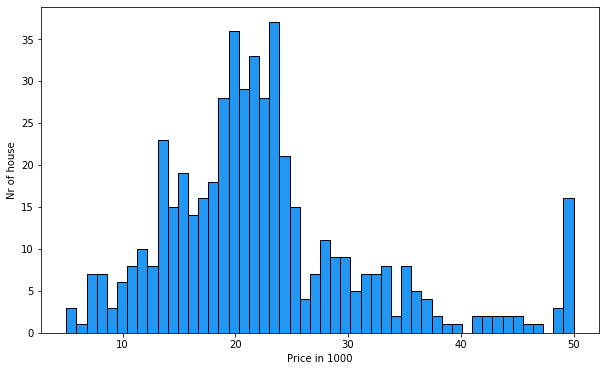

In [17]:
plt.figure(figsize=(10,6))
plt.hist(data['PRICE'], bins=50, ec ='black', color='#2196f3')
plt.xlabel('Price in 1000')
plt.ylabel('Nr of house')
plt.show()

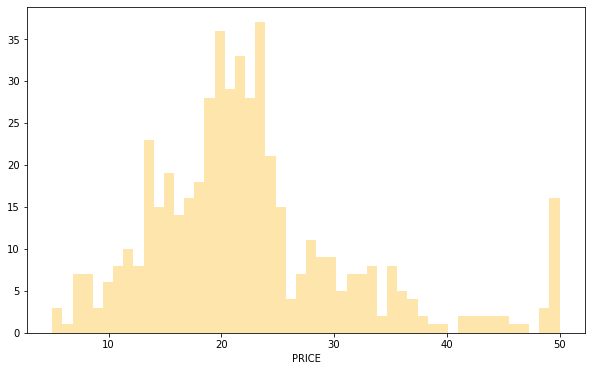

In [18]:
plt.figure(figsize=(10,6))
sns.distplot(data['PRICE'], bins=50, hist=True, kde=False, color='#fbc02d')#hist = false nu va arata hisyogram , iar daca kde = false nu va arata probalitatile
plt.show()
#optinem o histograma si o functie a densitati probabilitati

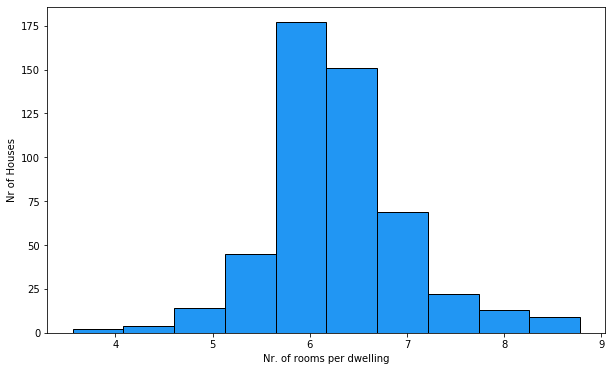

In [19]:
#Challeng 'RM'
plt.figure(figsize=(10,6))
plt.hist(data['RM'],  ec ='black', color='#2196f3')
plt.xlabel('Nr. of rooms per dwelling')
plt.ylabel('Nr of Houses')
plt.show()

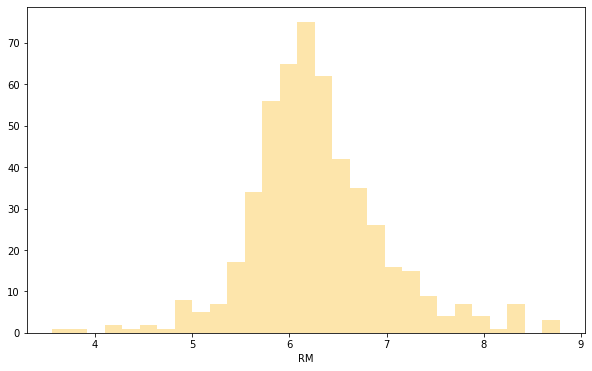

In [20]:
plt.figure(figsize=(10,6))
sns.distplot(data['RM'],  hist=True, kde=False, color='#fbc02d')
plt.show()

In [21]:
data['RM'].mean()

6.284634387351779

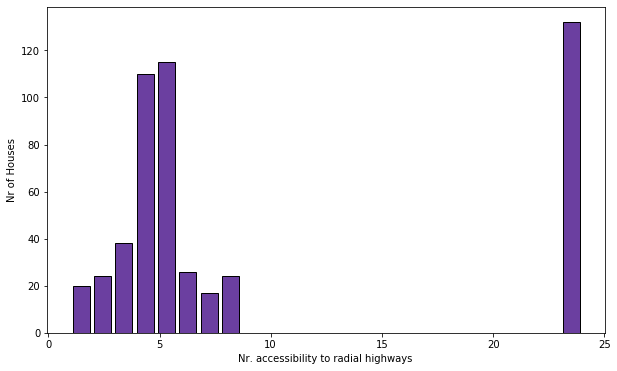

In [22]:
#Challenge 'RAD'
plt.figure(figsize=(10,6))
plt.hist(data['RAD'], bins=24, rwidth=0.8 ,ec ='black', color='#6b3fa0')#pentru a separa hist una de cealata folosim rwidth cu valoarea intre 0-1
plt.xlabel('Nr. accessibility to radial highways ')
plt.ylabel('Nr of Houses')
plt.show()

In [23]:
data['RAD'].value_counts()


24.0    132
5.0     115
4.0     110
3.0      38
6.0      26
8.0      24
2.0      24
1.0      20
7.0      17
Name: RAD, dtype: int64

In [24]:
frequency = data['RAD'].value_counts()
#type(frequency)
#optinem randurile din coloana intai
# frequency.index
#frequency.axes[0]

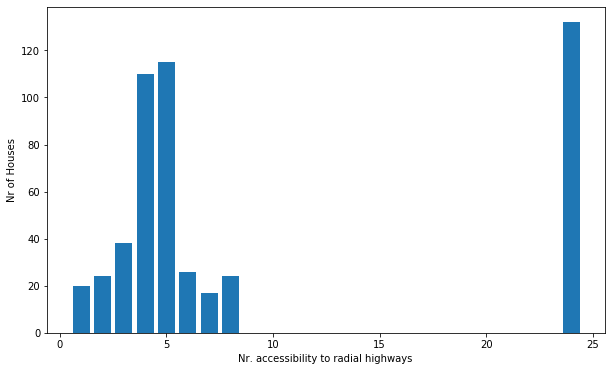

In [25]:

plt.figure(figsize=(10,6))

plt.xlabel('Nr. accessibility to radial highways ')
plt.ylabel('Nr of Houses')
plt.bar(frequency.index, height=frequency)
plt.show()

In [26]:
# Challeng cate propietati sunt langa rau/fluviu? si daca pretul popietati este mare sau mic?
r = data['CHAS'].value_counts()#daummy Variable , propietatea este langa rau sau nu,este femei sau barbat, este angajat sau nu, acesta este un  fel de informati pe care le intalneti intr-o variabila daummy
r

0.0    471
1.0     35
Name: CHAS, dtype: int64

# Ststistici Descriptive

Mean = medie, valoarea centrală, calculată ca suma tuturor valorilor împărțite la numărul de articole.

median = se alege doua puncte unul pentru poor unul pentru bogati si se alege punctul din mijloc, punctul mediu al distribuției, valoarea medie.

In [27]:
data['PRICE'].min()

5.0

In [28]:
data['PRICE'].max()

50.0

In [29]:
data.min()

CRIM         0.00632
ZN           0.00000
INDUS        0.46000
CHAS         0.00000
NOX          0.38500
RM           3.56100
AGE          2.90000
DIS          1.12960
RAD          1.00000
TAX        187.00000
PTRATIO     12.60000
B            0.32000
LSTAT        1.73000
PRICE        5.00000
dtype: float64

In [30]:
data.max()

CRIM        88.9762
ZN         100.0000
INDUS       27.7400
CHAS         1.0000
NOX          0.8710
RM           8.7800
AGE        100.0000
DIS         12.1265
RAD         24.0000
TAX        711.0000
PTRATIO     22.0000
B          396.9000
LSTAT       37.9700
PRICE       50.0000
dtype: float64

In [31]:
data.mean()

CRIM         3.613524
ZN          11.363636
INDUS       11.136779
CHAS         0.069170
NOX          0.554695
RM           6.284634
AGE         68.574901
DIS          3.795043
RAD          9.549407
TAX        408.237154
PTRATIO     18.455534
B          356.674032
LSTAT       12.653063
PRICE       22.532806
dtype: float64

In [32]:
data.median()

CRIM         0.25651
ZN           0.00000
INDUS        9.69000
CHAS         0.00000
NOX          0.53800
RM           6.20850
AGE         77.50000
DIS          3.20745
RAD          5.00000
TAX        330.00000
PTRATIO     19.05000
B          391.44000
LSTAT       11.36000
PRICE       21.20000
dtype: float64

In [33]:
data.describe()

,CRIM,ZN,INDUS,CHAS,NOX,RM,AGE,DIS,RAD,TAX,PTRATIO,B,LSTAT,PRICE
count,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000
mean,3.613524,11.363636,11.136779,0.069170,0.554695,6.284634,68.574901,3.795043,9.549407,408.237154,18.455534,356.674032,12.653063,22.532806
std,8.601545,23.322453,6.860353,0.253994,0.115878,0.702617,28.148861,2.105710,8.707259,168.537116,2.164946,91.294864,7.141062,9.197104
min,0.006320,0.000000,0.460000,0.000000,0.385000,3.561000,2.900000,1.129600,1.000000,187.000000,12.600000,0.320000,1.730000,5.000000
25%,0.082045,0.000000,5.190000,0.000000,0.449000,5.885500,45.025000,2.100175,4.000000,279.000000,17.400000,375.377500,6.950000,17.025000
50%,0.256510,0.000000,9.690000,0.000000,0.538000,6.208500,77.500000,3.207450,5.000000,330.000000,19.050000,391.440000,11.360000,21.200000
75%,3.677083,12.500000,18.100000,0.000000,0.624000,6.623500,94.075000,5.188425,24.000000,666.000000,20.200000,396.225000,16.955000,25.000000
max,88.976200,100.000000,27.740000,1.000000,0.871000,8.780000,100.000000,12.126500,24.000000,711.000000,22.000000,396.900000,37.970000,50.000000


# Correlatie
corelatie =$\rho$ rho si este calculat ca un singur numa intre -1.0<= coor<=1.0, -1 find o corelatie perfecta iar 1 find o corelatie perfect pozitiva, o coletatie a 0 (0.12) inseamna ca nu exista corelatie.

de ce ar trebui sa ne uitam la corelatie? de ce conteaza aceasta corelatie? de ne-ar pasa de aceasta corelatie? 
Raspunsul ar fi ca ne intereseaza doar doua lucruri:
puterea de corelatie si directia de corelatie
deoare ce modelul nostru trebuies sa cuprinda featurea care sa fie puternic corelate intre ele pentru a pute prezice, iar directia ne arata daca este pozitiva sau negativa

## $$ \rho -{XY} = corr(X,Y)$$
## $$-1.0 \leq \rho _{XY} \leq +1.0 $$

In [34]:
data['PRICE'].corr(data['RM'])

0.6953599470715396

In [35]:
#Challenge : Calculeaza corelatia dintre pretul propietati si pupil teacher ratio
data['PRICE']. corr(data['PTRATIO']) #PTRATIO masoara calitate invatari, cu cat calitatea invatamtului este mai prost cu ata pretul va scadea

-0.5077866855375618

In [36]:
data.corr() #Person Correlation Coefficients

,CRIM,ZN,INDUS,CHAS,NOX,RM,AGE,DIS,RAD,TAX,PTRATIO,B,LSTAT,PRICE
CRIM,1.000000,-0.200469,0.406583,-0.055892,0.420972,-0.219247,0.352734,-0.379670,0.625505,0.582764,0.289946,-0.385064,0.455621,-0.388305
ZN,-0.200469,1.000000,-0.533828,-0.042697,-0.516604,0.311991,-0.569537,0.664408,-0.311948,-0.314563,-0.391679,0.175520,-0.412995,0.360445
INDUS,0.406583,-0.533828,1.000000,0.062938,0.763651,-0.391676,0.644779,-0.708027,0.595129,0.720760,0.383248,-0.356977,0.603800,-0.483725
CHAS,-0.055892,-0.042697,0.062938,1.000000,0.091203,0.091251,0.086518,-0.099176,-0.007368,-0.035587,-0.121515,0.048788,-0.053929,0.175260
NOX,0.420972,-0.516604,0.763651,0.091203,1.000000,-0.302188,0.731470,-0.769230,0.611441,0.668023,0.188933,-0.380051,0.590879,-0.427321
RM,-0.219247,0.311991,-0.391676,0.091251,-0.302188,1.000000,-0.240265,0.205246,-0.209847,-0.292048,-0.355501,0.128069,-0.613808,0.695360
AGE,0.352734,-0.569537,0.644779,0.086518,0.731470,-0.240265,1.000000,-0.747881,0.456022,0.506456,0.261515,-0.273534,0.602339,-0.376955
DIS,-0.379670,0.664408,-0.708027,-0.099176,-0.769230,0.205246,-0.747881,1.000000,-0.494588,-0.534432,-0.232471,0.291512,-0.496996,0.249929
RAD,0.625505,-0.311948,0.595129,-0.007368,0.611441,-0.209847,0.456022,-0.494588,1.000000,0.910228,0.464741,-0.444413,0.488676,-0.381626
TAX,0.582764,-0.314563,0.720760,-0.035587,0.668023,-0.292048,0.506456,-0.534432,0.910228,1.000000,0.460853,-0.441808,0.543993,-0.468536


#corelatie mare intre features poate fi ...(depinde) dar tine spre a fi problematica
predictia densitati oaselor folosind urmatoarele data:
1) varsta
2) procentrul de grasime din corp
3) Greutatea
procentrul de grasime din corp si Greutatea au o  corelatie mare si este foarte difici sa arati corelatia dintre cele doua, aceasta are si o denumire numita multicolinearitate, aceta duce in estimări nesigure și constatări nesensibile, (modelul devine confuz). corelatia mare nu inseamna intotdeauna ca este multicolinearitate, ar trebui sa ne uitam la aceste corelatiintre feature, ar trebui sa iinvestigam , corelatie mare este un semn de intrebare/avertizare

In [37]:
mask = np.zeros_like(data.corr())
triangle_indices = np.triu_indices_from(mask)
mask[triangle_indices]= True
mask

array([[1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
       [0., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
       [0., 0., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
       [0., 0., 0., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
       [0., 0., 0., 0., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
       [0., 0., 0., 0., 0., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
       [0., 0., 0., 0., 0., 0., 1., 1., 1., 1., 1., 1., 1., 1.],
       [0., 0., 0., 0., 0., 0., 0., 1., 1., 1., 1., 1., 1., 1.],
       [0., 0., 0., 0., 0., 0., 0., 0., 1., 1., 1., 1., 1., 1.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 1., 1., 1., 1.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 1., 1., 1.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 1., 1.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 1.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1.]])

<function matplotlib.pyplot.show(*args, **kw)>

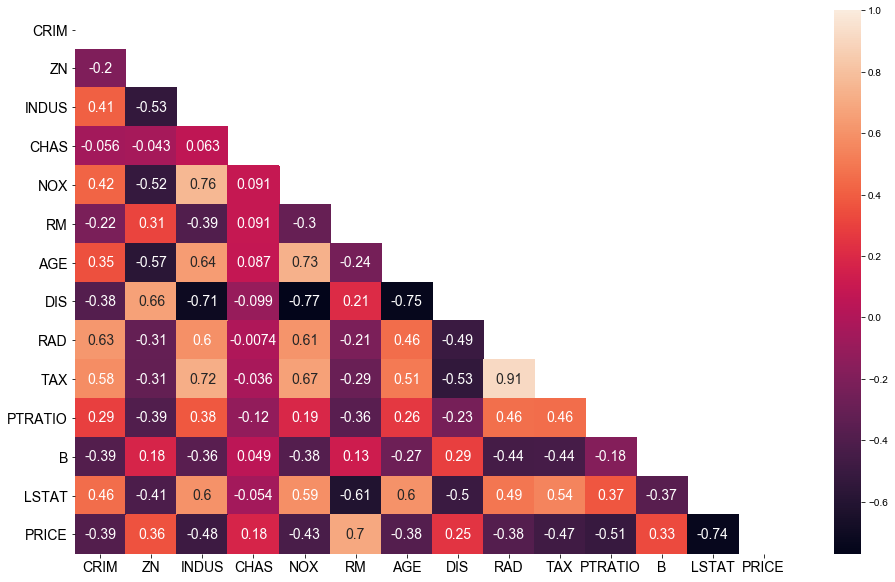

In [38]:
plt.figure(figsize=(16, 10))
sns.heatmap(data.corr(), mask=mask, annot=True, annot_kws={"size": 14})
sns.set_style('white')

plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.show

acesta coreleatie nu este valida daca nu este continua cum este cazul variabilei dawmp, corelatia nu inplica cauzalitatea,alta limitare este ca verifica sa fie o relatie de linearitate()

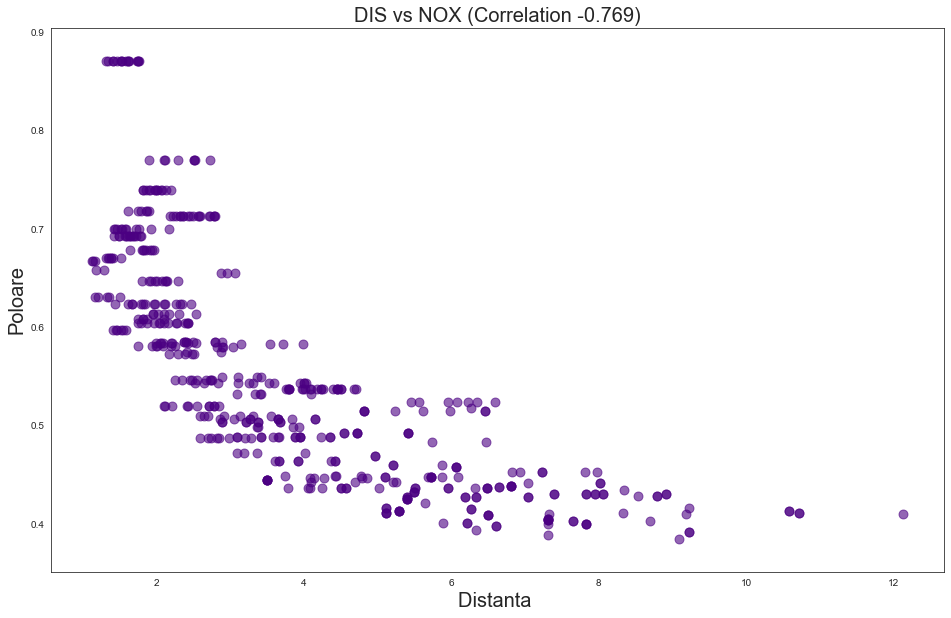

In [39]:
#Challeng: Creaza o imagine in mine a relatia dintre poluare si distanta.
#Apoi creaza un scatter plot dintre DIS and NOS 
nox_dis_corr = round(data['NOX'].corr(data['DIS']), 3)# ce va in plus fata de challeng

plt.figure(figsize=(16, 10))

plt.scatter(data['DIS'],data['NOX'], alpha=0.6, s= 80, color= 'indigo')

plt.title(f'DIS vs NOX (Correlation {nox_dis_corr})', fontsize =20 )

plt.xlabel('Distanta ', fontsize =20)
plt.ylabel('Poloare', fontsize = 20)
plt.show()

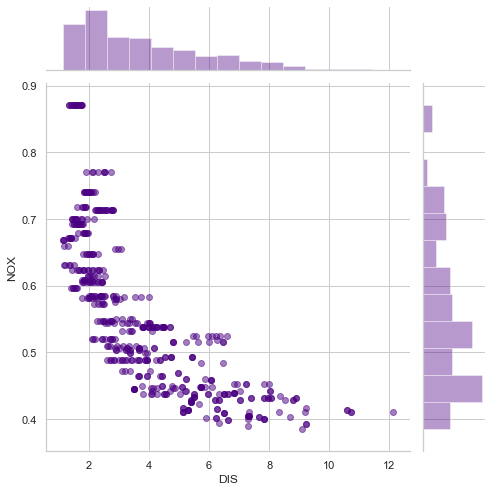

In [40]:
sns.set()#restar stylul catre deful
sns.set_context("notebook")
sns.set_style('whitegrid')

sns.jointplot(x=data['DIS'], y =data['NOX'], size= 7, color='indigo', joint_kws={'alpha': 0.5})
plt.show()

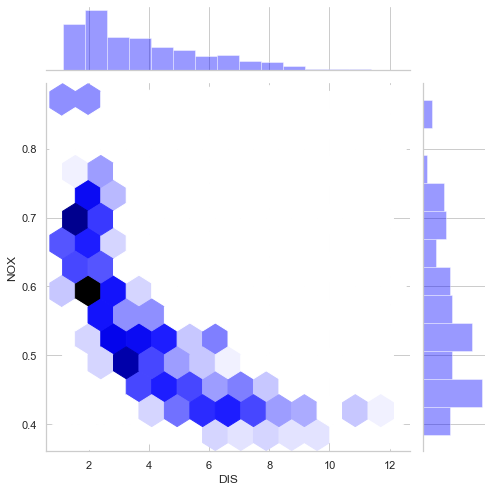

In [41]:
sns.set()#restar stylul catre deful
sns.set_context("notebook")
sns.set_style('whitegrid')

sns.jointplot(x=data['DIS'], y =data['NOX'], kind = 'hex' ,size= 7, color='blue' )
plt.show()

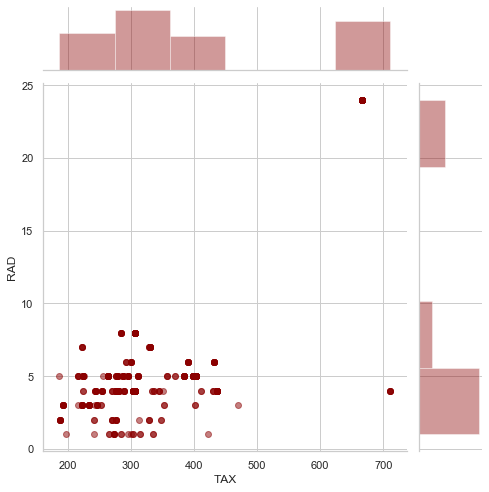

In [42]:
sns.set()#restar stylul catre deful
sns.set_context("notebook")
sns.set_style('whitegrid')

sns.jointplot(x=data['TAX'], y =data['RAD'], size= 7, color='darkred', joint_kws={'alpha': 0.5})
plt.show()

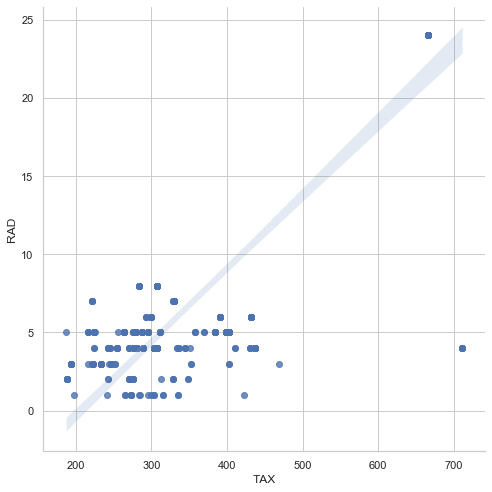

In [43]:
#aplicare unei regresi liniare
sns.lmplot(x='TAX', y='RAD', data=data, size=7)
plt.show()


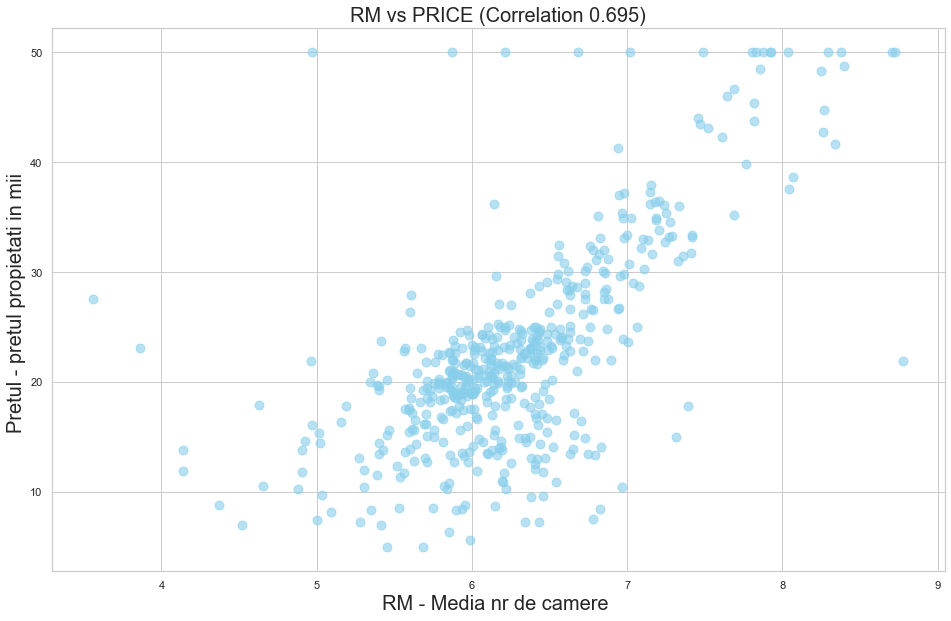

In [44]:
#Challenge: Creaza un scatter plot dintre pretul caselor si numarul de camere (RM)
prices_rm_corr = round(data['PRICE'].corr(data['RM']), 3)
plt.figure(figsize=(16, 10))

plt.scatter(data['RM'],data['PRICE'], alpha=0.6, s= 80, color= 'skyblue')

plt.title(f'RM vs PRICE (Correlation {prices_rm_corr})', fontsize =20 )

plt.xlabel('RM - Media nr de camere ', fontsize =20)
plt.ylabel('Pretul - pretul propietati in mii ', fontsize = 20)
plt.show()

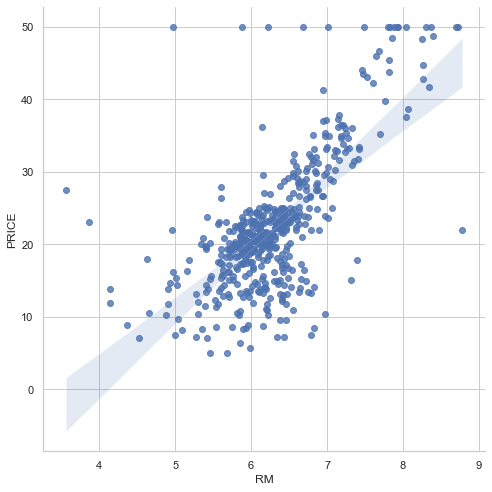

In [45]:
#metoda 2
sns.lmplot(x='RM', y='PRICE', data=data, size=7)
plt.show()

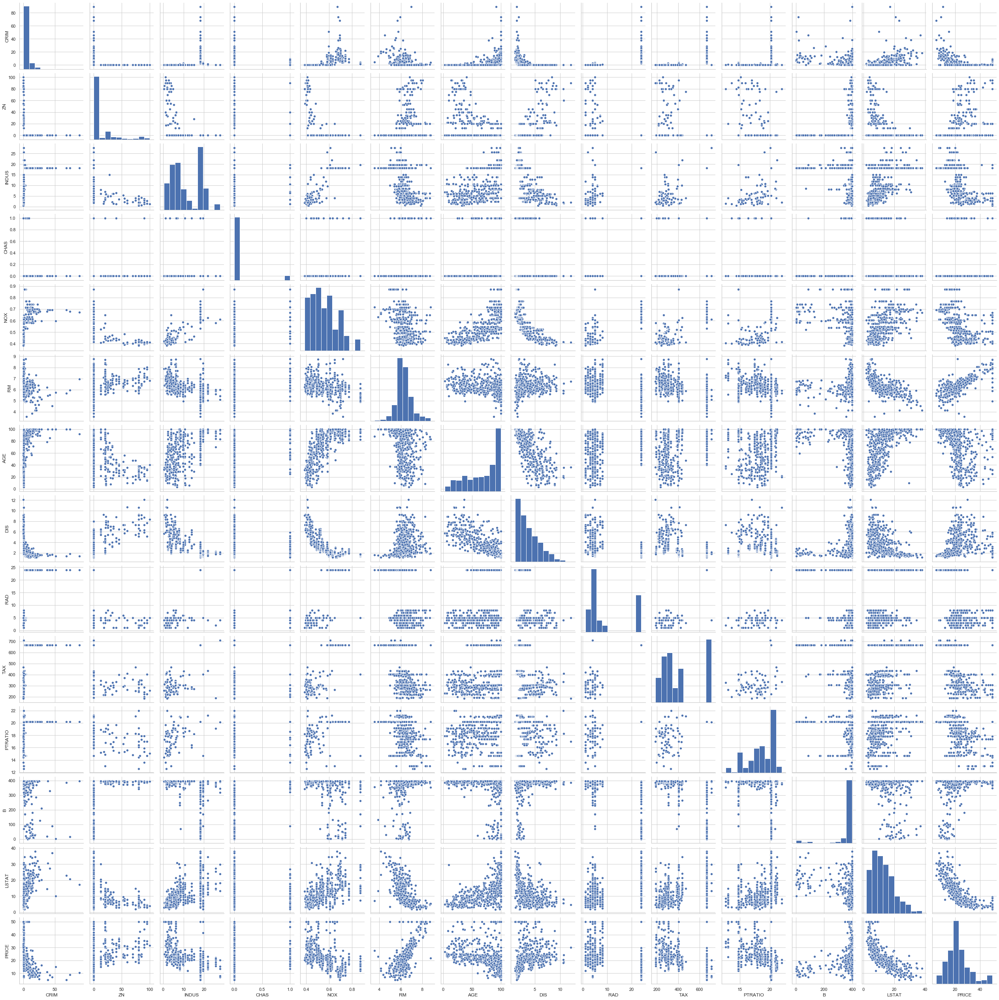

In [46]:

#%%time #banch

sns.pairplot(data)
plt.show()

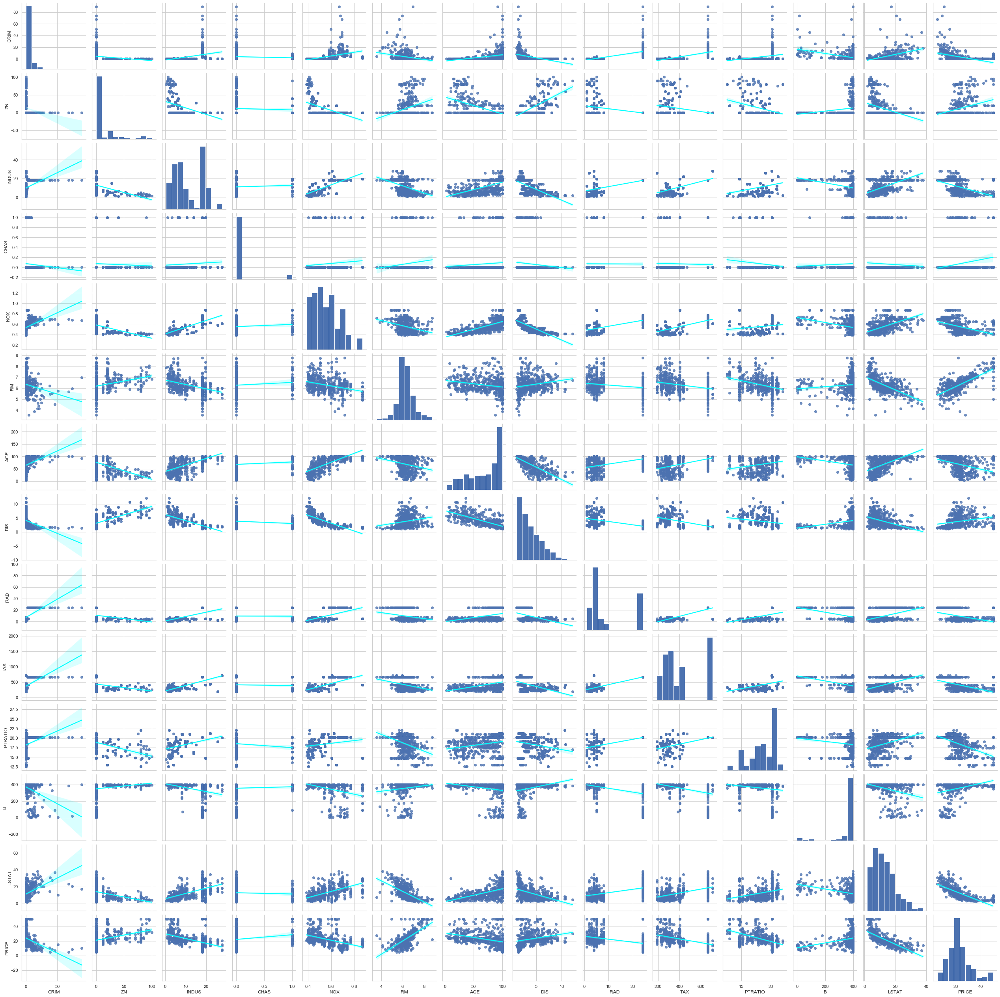

In [47]:
sns.pairplot(data, kind='reg', plot_kws={'line_kws': {'color': 'cyan'}}) # reg = regresie, 
plt.show()

# Regresie multivariabilă /Regresie multipla liniara

## formula pentru regresie simpla liniara : $\hat y = \theta_0 + \theta_1x $
## Formula pentru regresia multipla liniara: $\hat y = \theta_0 + \theta_1x_1 + \theta_2x_2 + ... + \theta_nx_n$
Modelul nostru va arata asa:
# $\hat{PRICE} =  \theta_0 + \theta_1RM + \theta_2NOX + ... + \theta_{13}LSTAT$

# Split Training & Test data

In [48]:
prices = data['PRICE']
features = data.drop('PRICE', axis=1) #daca axis = 1 este vorba de colona , iar daca axis = 0 este vorba de rand

x_train, x_test, y_train, y_test = train_test_split(features, prices,
                                                    test_size=0.2, random_state=10)#radom_state=10 cu aceasta inpartire nu va mai fi random pentru diferitii utilizatori/dupa diferite incercari

# % din training set
len(x_train)/len(features)

0.7984189723320159

In [49]:
# % din test data set
x_test.shape[0]/features.shape[0]

0.2015810276679842

# Regresie multiple

In [50]:
regr = LinearRegression()
regr.fit(x_train, y_train)

#challenge
print('Intercept', regr.intercept_)
pd.DataFrame(data=regr.coef_, index=x_train.columns, columns=['coef'])

Intercept 36.53305138282418


,coef
CRIM,-0.128181
ZN,0.063198
INDUS,-0.007576
CHAS,1.974515
NOX,-16.271989
RM,3.108456
AGE,0.016292
DIS,-1.483014
RAD,0.303988
TAX,-0.012082


Modelul nostru va arata asa:
# $\hat{PRICE} =  36.6 + 3.1RM - 16.3NOX - 1.5 DIS + 2.0 CHAS + ... - 0.6 LSTAT$
cretere cu o camera(RM) a propietati va duce la o crestere a propietati  cu 3.1 mii de dolari 

# Callenge printeza r-square($R^2$) pentru training  si test datasets
$R^2$ = regr.score(x,y)

In [51]:
#R^2 = r-square/accuracy pentru train, 
print('Acuratetea pentru training data: ',regr.score(x_train, y_train))
#R^2 = pentru test
print('Acuratetea pentru test data: ',regr.score(x_test, y_test))

Acuratetea pentru training data:  0.750121534530608
Acuratetea pentru test data:  0.6709339839115636


# Evaluarea modelului

R - squared

p-values

V.I.F - factorul inflației de varianță (variance inflation factor)

B.I.C -Criteriul informațional bayesian

# Transformări de date ( avand mai multe puncte in coada se numeste skew)

In [52]:
data['PRICE'].skew() # o distributie normala skew este 0

1.1080984082549072

transformare a datelor
if price = 7 -> ln(7) =1.95
if price = 50 -> ln(50) =3.91
trebuies sa transforma datele si apoi tragem o line a regresiei

In [53]:
y_log = np.log(data['PRICE'])
y_log.tail()

501    3.109061
502    3.025291
503    3.173878
504    3.091042
505    2.476538
Name: PRICE, dtype: float64

In [54]:
y_log.skew()

-0.33032129530987864

Text(0.5, 1.0, 'Log pret cu skew -0.33032129530987864')

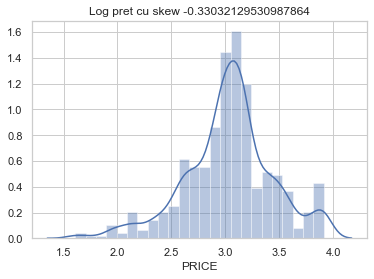

In [55]:
sns.distplot(y_log)
plt.title(f'Log pret cu skew {y_log.skew()}')

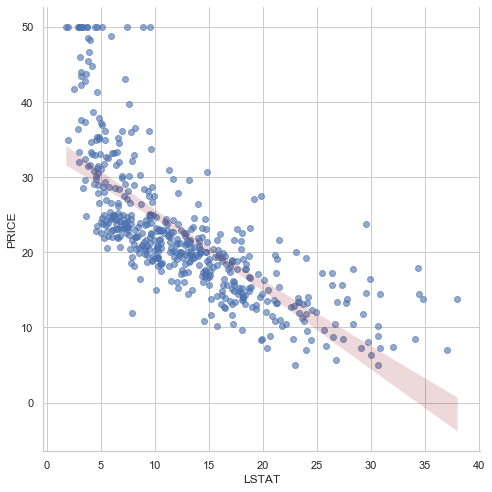

In [56]:
sns.lmplot(x='LSTAT', y='PRICE', data=data, size=7, scatter_kws={'alpha':0.6}, line_kws={'color': 'darkred'})

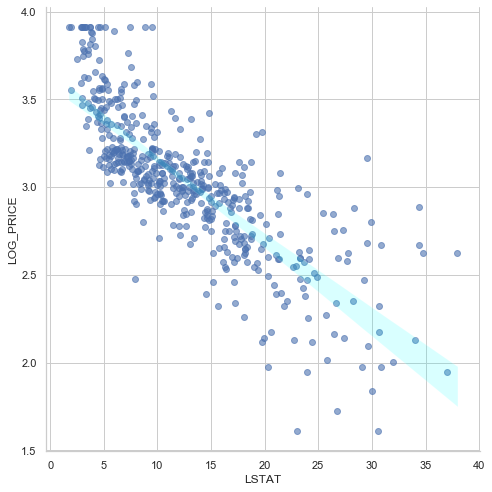

In [57]:
transformed_data = features
transformed_data['LOG_PRICE'] = y_log

sns.lmplot(x='LSTAT', y='LOG_PRICE', data=transformed_data, size=7, scatter_kws={'alpha':0.6}, line_kws={'color': 'cyan'})
plt.show()

# $\hat{PRICE} =  \theta_0 + \theta_1RM + \theta_2NOX + ... + \theta_{13}LSTAT$
#transformarea a datelor
# $log(\hat{PRICE}) =  \theta_0 + \theta_1RM + \theta_2NOX + ... + \theta_{13}LSTAT$
# $regr.intercept\_ = \theta_0$
# $regr.coef\_  = \theta_n$

## Regresie folosind log pret

### reducand skew in target(pretul) optine un rezultat mai bun

In [58]:
prices = np.log(data['PRICE'])
features = data.drop('PRICE', axis=1) #daca axis = 1 este vorba de colona , iar daca axis = 0 este vorba de rand

x_train, x_test, y_train, y_test = train_test_split(features, prices,
                                                    test_size=0.2, random_state=10)#radom_state=10 cu aceasta inpartire nu va mai fi random pentru diferitii utilizatori/dupa diferite incercari

regr = LinearRegression()
regr.fit(x_train, y_train)

#R^2 = r-square/accuracy pentru train, 
print('Acuratetea pentru training data: ',regr.score(x_train, y_train))
#R^2 = pentru test
print('Acuratetea pentru test data: ',regr.score(x_test, y_test))

print('Intercept', regr.intercept_) 
pd.DataFrame(data=regr.coef_, index=x_train.columns, columns=['coef'])

Acuratetea pentru training data:  0.7930234826697584
Acuratetea pentru test data:  0.7446922306260724
Intercept 4.059943871775182


,coef
CRIM,-0.010672
ZN,0.001579
INDUS,0.002030
CHAS,0.080331
NOX,-0.704068
RM,0.073404
AGE,0.000763
DIS,-0.047633
RAD,0.014565
TAX,-0.000645


# matematica

# $log_e(12) \approx 2.485 $

pentru a reversa :
# $e^{2.485} \approx 12$

In [59]:
#Raul charles propietate premiu
np.e**0.080331

1.0836456950439142

# Evaluarea coeficientului
# coeficientul care arata cat este de semnificativ este p-value

daca p-value <0.05 ... -> este semnificativ

daca p-value >0.05 ... -> nu este semnificativ
(0.05, este o censesiune in randul academin de al folosi)

## p-values 

In [60]:
x_incl_const = sm.add_constant(x_train)
model = sm.OLS(y_train, x_incl_const )# Ordinary Least Squares (OLS) - ne da o regresie liniara
results = model.fit()
#results.params
# results.pvalues
pd.DataFrame({'coef': results.params, 'p-value': round(results.pvalues, 3)})

,coef,p-value
const,4.059944,0.000
CRIM,-0.010672,0.000
ZN,0.001579,0.009
INDUS,0.002030,0.445
CHAS,0.080331,0.038
NOX,-0.704068,0.000
RM,0.073404,0.000
AGE,0.000763,0.209
DIS,-0.047633,0.000
RAD,0.014565,0.000


# Test pentru multicolinearitare
## este atunci cand 2 sau mai multe sunt valori prezise din regresie au o legatura foarte stransa intre ele in aces caz ele nu prezinta informati unice/ independente pentru model
## Problemele de muticolinuaritate sunt 
## 1) pierderea increderi in estimarile unui efect pentru feature individuale 
## 2) variabilitate mare în - $\theta_0$ estimări pentru schimbari mici in model(ex: adugare sau stergerea unui feature are un efect dramatic asupra modelului, acesta devenind instabil ba chiar schimban semnele de la pozitiv la negati sau de la negativ la pozitiv)
## 3)Constatări ciudate/ nu face sens
## Pentru a verifica aces lucru trebuie sa ne uitam la Factor de inflație varianță(VIF)

Formula
# PASUL 1 ESTE CALCULATA $R_{TAX}^2$
# $$ TAX = \alpha_0 + \alpha_1 RM + \alpha_2 NOS + ... +\alpha_{12}LSTAT $$
# Pasul 2 este calculat $VIF_{TAX}$
# $$ VIF_{TAX} = \frac{1}{(1-R_{TAX}^2)} $$

In [61]:
variance_inflation_factor(exog=x_incl_const.values, exog_idx=1)# rezultatul este pentru Crime, exog_idx spune la ce colona ar trebui sa se uite pentru a face calculul
# type(x_incl_const)

1.7145250443932485

In [62]:
#Challenge:print numarul de coloane din x_incl_const
len(x_incl_const.columns)
    
x_incl_const.shape[1]

14

In [63]:
x_incl_const

,const,CRIM,ZN,INDUS,CHAS,NOX,RM,AGE,DIS,RAD,TAX,PTRATIO,B,LSTAT
50,1.0,0.08873,21.0,5.64,0.0,0.439,5.963,45.7,6.8147,4.0,243.0,16.8,395.56,13.45
367,1.0,13.52220,0.0,18.10,0.0,0.631,3.863,100.0,1.5106,24.0,666.0,20.2,131.42,13.33
34,1.0,1.61282,0.0,8.14,0.0,0.538,6.096,96.9,3.7598,4.0,307.0,21.0,248.31,20.34
78,1.0,0.05646,0.0,12.83,0.0,0.437,6.232,53.7,5.0141,5.0,398.0,18.7,386.40,12.34
172,1.0,0.13914,0.0,4.05,0.0,0.510,5.572,88.5,2.5961,5.0,296.0,16.6,396.90,14.69
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
320,1.0,0.16760,0.0,7.38,0.0,0.493,6.426,52.3,4.5404,5.0,287.0,19.6,396.90,7.20
15,1.0,0.62739,0.0,8.14,0.0,0.538,5.834,56.5,4.4986,4.0,307.0,21.0,395.62,8.47
484,1.0,2.37857,0.0,18.10,0.0,0.583,5.871,41.9,3.7240,24.0,666.0,20.2,370.73,13.34
125,1.0,0.16902,0.0,25.65,0.0,0.581,5.986,88.4,1.9929,2.0,188.0,19.1,385.02,14.81


In [64]:
#Chalenge : creaza o for loop pentru a printa toate VIF pentru toate features
for i in range(x_incl_const.shape[1]):
    print(variance_inflation_factor(exog=x_incl_const.values, exog_idx=i))
        

               


597.5487126763895
1.7145250443932485
2.3328224265597597
3.943448822674636
1.0788133385000576
4.410320817897635
1.8404053075678573
3.3267660823099394
4.222923410477865
7.314299817005058
8.508856493040817
1.8399116326514058
1.338671325536472
2.812544292793036


In [65]:
vif = []
for i in range(x_incl_const.shape[1]):
    vif.append(variance_inflation_factor(exog=x_incl_const.values, exog_idx=i))
print(vif)

[597.5487126763895, 1.7145250443932485, 2.3328224265597597, 3.943448822674636, 1.0788133385000576, 4.410320817897635, 1.8404053075678573, 3.3267660823099394, 4.222923410477865, 7.314299817005058, 8.508856493040817, 1.8399116326514058, 1.338671325536472, 2.812544292793036]


In [66]:
vif = [variance_inflation_factor(exog=x_incl_const.values, 
                                exog_idx=i) for i in range(x_incl_const.shape[1])]
print(vif)
pd.DataFrame({'coef_name' : x_incl_const.columns,
'vif' : np.around(vif, 2)})

[597.5487126763895, 1.7145250443932485, 2.3328224265597597, 3.943448822674636, 1.0788133385000576, 4.410320817897635, 1.8404053075678573, 3.3267660823099394, 4.222923410477865, 7.314299817005058, 8.508856493040817, 1.8399116326514058, 1.338671325536472, 2.812544292793036]


,coef_name,vif
0,const,597.55
1,CRIM,1.71
2,ZN,2.33
3,INDUS,3.94
4,CHAS,1.08
5,NOX,4.41
6,RM,1.84
7,AGE,3.33
8,DIS,4.22
9,RAD,7.31


#comparam VIF cu 10 daca VIF>10 atunci este proplematic si ar trebui o inspectie

# Simplificarea modelului si BIC

In [70]:
#Modelul original cu log pret si toate features

x_incl_const = sm.add_constant(x_train)

model = sm.OLS(y_train, x_incl_const )
results = model.fit()

org_coef = pd.DataFrame({'coef': results.params, 'p-value': round(results.pvalues, 3)})

#Challenge : gaseste si verifica doc oficiale  din resultatele obiectului si print BIC si R-squared
#R: vom cauta pe google dupa 'statsmodel regression re' 
print('BIC este: ', results.bic)
print('r-squared este: ' ,results.rsquared)


BIC este:  -139.74997769478898
r-squared este:  0.7930234826697584


In [71]:
#Reducerea modelului # 1 excludem INDUS

x_incl_const = sm.add_constant(x_train)
x_incl_const = x_incl_const.drop(['INDUS'], axis=1)

model = sm.OLS(y_train, x_incl_const )
results = model.fit()

coef_minus_indus = pd.DataFrame({'coef': results.params, 'p-value': round(results.pvalues, 3)})


print('BIC este: ', results.bic)
print('r-squared este: ' ,results.rsquared)

BIC este:  -145.14508855591163
r-squared este:  0.7927126289415163


In [72]:
#Reducerea modelului # 1 excludem INDUS si AGE# aceasta reduce complexitate modelului dar nu intodeauna este bine sa reducem daca r-squared scade fata de modelul original, totodata trebuie sa scada si BIC 

x_incl_const = sm.add_constant(x_train)
x_incl_const = x_incl_const.drop(['INDUS','AGE'], axis=1)

model = sm.OLS(y_train, x_incl_const )
results = model.fit()

coef_minus_indus_age = pd.DataFrame({'coef': results.params, 'p-value': round(results.pvalues, 3)})


print('BIC este: ', results.bic)
print('r-squared este: ' ,results.rsquared)

BIC este:  -149.49934294224678
r-squared este:  0.7918657661852815


In [73]:
frames = [org_coef, coef_minus_indus, coef_minus_indus_age]
pd.concat(frames, axis=1)

,coef,p-value,coef,p-value,coef,p-value
const,4.059944,0.000,4.056231,0.000,4.035922,0.000
CRIM,-0.010672,0.000,-0.010721,0.000,-0.010702,0.000
ZN,0.001579,0.009,0.001551,0.010,0.001461,0.014
INDUS,0.002030,0.445,NaN,NaN,NaN,NaN
CHAS,0.080331,0.038,0.082795,0.032,0.086449,0.025
NOX,-0.704068,0.000,-0.673365,0.000,-0.616448,0.000
RM,0.073404,0.000,0.071739,0.000,0.076133,0.000
AGE,0.000763,0.209,0.000766,0.207,NaN,NaN
DIS,-0.047633,0.000,-0.049394,0.000,-0.052692,0.000
RAD,0.014565,0.000,0.014014,0.000,0.013743,0.000


# Rezidurile si plots Rezidurile
Diferenta dintre valoarea targetata/observata si valoarea prezisa/fit $Rezidurile =(y - \hat y)$ 

Folosit pentru a verifica dacă ipotezele se păstrează și modelul este valid

Rezidurile are trebui sa fie random (adică, fără model)

Rezidurile ar tebui sa fie normal distribuite (ele ar tebui sa se afle in jurul lui 0)
(ep 24)

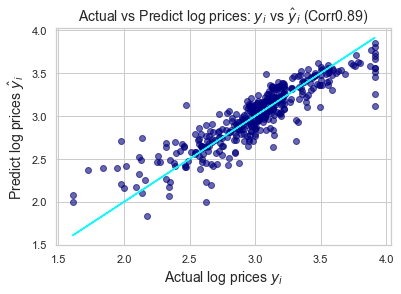

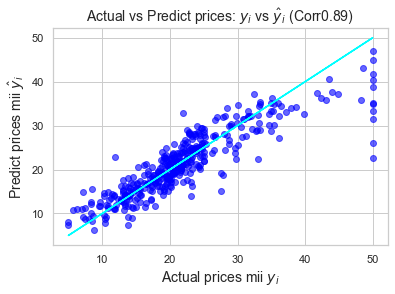

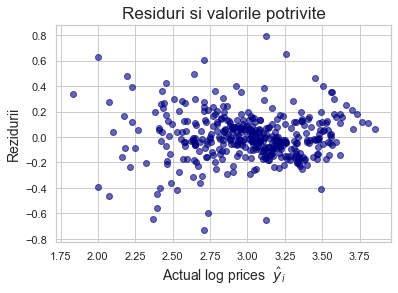

In [110]:
#Modificarea modelului : transformare(folosind log prices) si simplificare (eliminand doua features)

prices = np.log(data['PRICE'])
features = data.drop(['PRICE','INDUS','AGE'], axis=1) #daca axis = 1 este vorba de colona , iar daca axis = 0 este vorba de rand

x_train, x_test, y_train, y_test = train_test_split(features, prices,
                                                    test_size=0.2, random_state=10)#radom_state=10 cu aceasta inpartire nu va mai fi random pentru diferitii utilizatori/dupa diferite incercari

#folosim Statsmodel
x_incl_const = sm.add_constant(x_train)
model = sm.OLS(y_train, x_incl_const )
results = model.fit()

#Rezidurile
#residuals = y_train - results.fittedvalues # (y - \hat y), y_train (este y) iar results.fittedvalues (este \hat y)
#results.resid# a doua metoda de a afla rezidurile

#Grafic pentru Actaual vs predict  pret
corr = round(y_train.corr(results.fittedvalues), 2)
plt.scatter(x=y_train, y=results.fittedvalues, c='navy', alpha=0.6)
plt.plot(y_train, y_train, color= 'cyan')

plt.xlabel('Actual log prices $y_i$', fontsize = 14)
plt.ylabel('Predict log prices $\hat y_i$',fontsize = 14)
plt.title(f'Actual vs Predict log prices: $y_i$ vs $\hat y_i$ (Corr{corr}) ', fontsize = 14)

plt.show()

#Pretul fara log
corr = round(y_train.corr(results.fittedvalues), 2)
plt.scatter(x=np.e**y_train, y=np.e**results.fittedvalues, c='blue', alpha=0.6)
plt.plot(np.e**y_train, np.e**y_train, color= 'cyan')

plt.xlabel('Actual prices mii $y_i$', fontsize = 14)
plt.ylabel('Predict prices mii $\hat y_i$',fontsize = 14)
plt.title(f'Actual vs Predict prices: $y_i$ vs $\hat y_i$ (Corr{corr}) ', fontsize = 14)

plt.show()

#Reziduri vs Valoarea Prezisa
corr = round(y_train.corr(results.fittedvalues), 2)
plt.scatter(x=results.fittedvalues, y=results.resid, c='navy', alpha=0.6)

plt.xlabel('Actual log prices  $\hat y_i$', fontsize = 14)
plt.ylabel('Rezidurii',fontsize = 14)
plt.title(f'Residuri si valorile potrivite', fontsize = 17)

plt.show()

#Mena Squared Erros si R-squared
Reduced_log_mse =  round(results.mse_resid, 3)
Reduced_log_rsquared =  round(results.rsquared, 3)

# Normalitate

Text(0.5, 1.0, 'Log prices models : residuri Skew (0.118) Mean (0.0)')

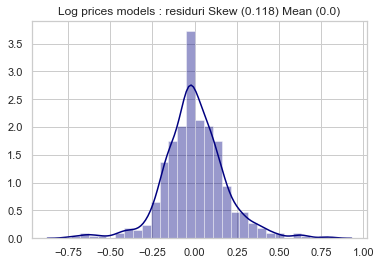

In [94]:
#Distributia a residurilor (log prices) - verificarea dupa normalitate
resid_mean = round(results.resid.mean(), 3)
resid_skew = round(results.resid.skew(), 3)

sns.distplot(results.resid, color='navy')
plt.title(f'Log prices models : residuri Skew ({resid_skew}) Mean ({resid_mean})')

In [ ]:
#Challenge: folosind modelul original cu toatel features si pretul nurmal generat :
#Plot actul vs predict price (incl.  corelatia) folosind o culoare diferita
#Plot reziduri  vs. pretul prezis
#Plot distributia residurilor (incl. skew)
# Analizeaza rezultatuk


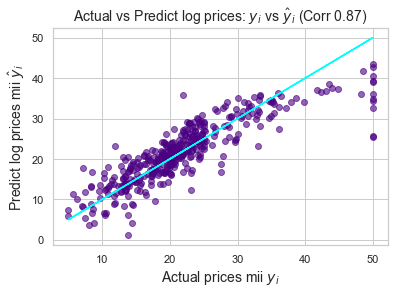

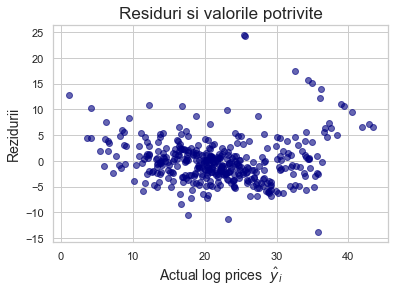

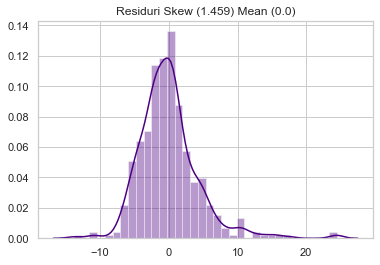

In [115]:
#Modelul original : normal pret si toate features

prices = data['PRICE']
features = data.drop(['PRICE'], axis=1) #daca axis = 1 este vorba de colona , iar daca axis = 0 este vorba de rand

x_train, x_test, y_train, y_test = train_test_split(features, prices,
                                                    test_size=0.2, random_state=10)#radom_state=10 cu aceasta inpartire nu va mai fi random pentru diferitii utilizatori/dupa diferite incercari

#folosim Statsmodel
x_incl_const = sm.add_constant(x_train)
model = sm.OLS(y_train, x_incl_const )
results = model.fit()


#Grafic pentru Actaual vs predict  pret
corr = round(y_train.corr(results.fittedvalues), 2)
plt.scatter(x=y_train, y=results.fittedvalues, c='indigo', alpha=0.6)
plt.plot(y_train, y_train, color= 'cyan')

plt.xlabel('Actual prices mii $y_i$', fontsize = 14)
plt.ylabel('Predict log prices mii $\hat y_i$',fontsize = 14)
plt.title(f'Actual vs Predict log prices: $y_i$ vs $\hat y_i$ (Corr {corr}) ', fontsize = 14)

plt.show()



#Reziduri vs Valoarea Prezisa

plt.scatter(x=results.fittedvalues, y=results.resid, c='navy', alpha=0.6)

plt.xlabel('Actual log prices  $\hat y_i$', fontsize = 14)
plt.ylabel('Rezidurii',fontsize = 14)
plt.title(f'Residuri si valorile potrivite', fontsize = 17)

plt.show()

#Graficul distributilor rezidurilor
resid_mean = round(results.resid.mean(), 3)
resid_skew = round(results.resid.skew(), 3)

sns.distplot(results.resid, color='indigo')
plt.title(f'Residuri Skew ({resid_skew}) Mean ({resid_mean})')

#Mena Squared Erros si R-squared
full_normal_mse =  round(results.mse_resid, 3)
full_normal_rsquared =  round(results.rsquared, 3)

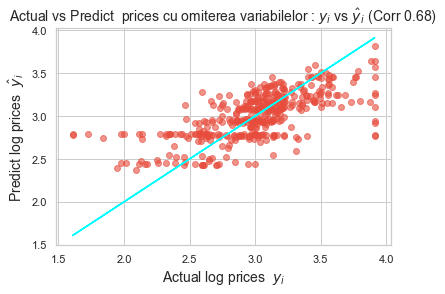

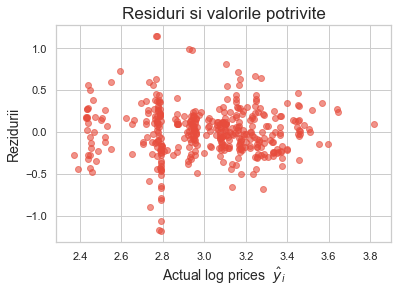

In [118]:
#Modelul omitem Features folosim log price

prices = np.log(data['PRICE'])
features = data.drop(['PRICE', 'INDUS', 'AGE', 'LSTAT', 'RM', 'NOX', 'CRIM'], axis=1) #daca axis = 1 este vorba de colona , iar daca axis = 0 este vorba de rand

x_train, x_test, y_train, y_test = train_test_split(features, prices,
                                                    test_size=0.2, random_state=10)#radom_state=10 cu aceasta inpartire nu va mai fi random pentru diferitii utilizatori/dupa diferite incercari

#folosim Statsmodel
x_incl_const = sm.add_constant(x_train)
model = sm.OLS(y_train, x_incl_const )
results = model.fit()


#Grafic pentru Actaual vs predict  pret
corr = round(y_train.corr(results.fittedvalues), 2)
plt.scatter(x=y_train, y=results.fittedvalues, c='#E74C3C', alpha=0.6)
plt.plot(y_train, y_train, color= 'cyan')

plt.xlabel('Actual log prices  $y_i$', fontsize = 14)
plt.ylabel('Predict log prices  $\hat y_i$',fontsize = 14)
plt.title(f'Actual vs Predict  prices cu omiterea variabilelor : $y_i$ vs $\hat y_i$ (Corr {corr}) ', fontsize = 14)

plt.show()



#Reziduri vs Valoarea Prezisa

plt.scatter(x=results.fittedvalues, y=results.resid, c='#E74C3C', alpha=0.6)

plt.xlabel('Actual log prices  $\hat y_i$', fontsize = 14)
plt.ylabel('Rezidurii',fontsize = 14)
plt.title(f'Residuri si valorile potrivite', fontsize = 17)

plt.show()

#Mena Squared Erros si R-squared
omitted_var_mse =  round(results.mse_resid, 3)
omitted_var_rsquared =  round(results.rsquared, 3)

In [119]:
#comparare 'R-Squared' vs 'MSE'
pd.DataFrame({'R-Squared' : [Reduced_log_rsquared, full_normal_rsquared, omitted_var_rsquared],
               'MSE' : [Reduced_log_mse, full_normal_mse, omitted_var_mse]},
               index = ['Reducere log Model', 'Full Normal Prices Model', 'Omitted Var Model'])

,R-Squared,MSE
0,0.792,0.035
1,0.750,19.921
2,0.460,0.090


# Facem predictii
## Root Mean Squared Error(RMSE)/ Rădăcina pătrată a erorii medii pătratice

## $$RMSE =  \sqrt{MSE} = \sqrt{\frac{1}{n}\sum_{i=1}^{n} \big(y - \hat{y} \big)^2} $$

## RMSE reprezintă abaterea standard a diferenței dintre valorile actuale și cele previzionate.
## Eroarea medie rădăcină rădăcină este o abatere standard în distribuția reziduurilor noastre

In [122]:
#comparare 'R-Squared' vs 'MSE' vs 'RMSE'
pd.DataFrame({'R-Squared' : [Reduced_log_rsquared, full_normal_rsquared, omitted_var_rsquared],
               'MSE' : [Reduced_log_mse, full_normal_mse, omitted_var_mse],
               'RMSE' : np.sqrt([Reduced_log_mse, full_normal_mse, omitted_var_mse])},
               index = ['Reducere log Model', 'Full Normal Prices Model', 'Omitted Var Model'])

,R-Squared,MSE,RMSE
Reducere log Model,0.792,0.035,0.187083
Full Normal Prices Model,0.750,19.921,4.463295
Omitted Var Model,0.460,0.090,0.300000


In [127]:
# Challenge : Estimarea noastră pentru prețurile casei este de 30000 USD. Calculați limita superioară și inferioară pentru un interval de predicție de 95% utilizând modelul de sarcină redusă

print( '1 s.d in log prices is ', np.sqrt(Reduced_log_mse) )
print( '2 s.d in log prices is ', 2*np.sqrt(Reduced_log_mse) )

upper_bound = np.log(30) +  2*np.sqrt(Reduced_log_mse)

print('The upper bound in log prices for a 95% prediction interval is ' , upper_bound)
print('The upper bound in normal prices  is $' , np.e**upper_bound *1000)

lower_bound = np.log(30) -  2*np.sqrt(Reduced_log_mse)

print('The lower bound in log prices for a 95% prediction interval is ' , lower_bound)
print('The lower bound in normal prices  is $' , np.e**lower_bound *1000)



1 s.d in log prices is  0.18708286933869708
2 s.d in log prices is  0.37416573867739417
The upper bound in log prices for a 95% prediction interval is  3.7753631203395495
The upper bound in normal prices  is  43613.34233239937
The lower bound in log prices for a 95% prediction interval is  3.0270316429847615
The lower bound in normal prices  is  20635.886906824155


# Cream un instrument de evaluare

In [1]:
from sklearn.datasets import load_boston
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error

import pandas as pd
import numpy as np



In [3]:
#get data
boston_dataset = load_boston()
data = pd.DataFrame(data = boston_dataset.data, columns=boston_dataset.feature_names)
features = data.drop(['INDUS', 'AGE'], axis= 1)

log_prices = np.log(boston_dataset.target)
target = pd.DataFrame(log_prices, columns=['PRICE'])


In [23]:
CRIME_IDX = 0
ZN_IDX = 1
CHAS_IDX = 2
RM_IDX = 4
PTRATIO_IDX = 8

# property_stats = np.ndarray(shape=(1,11))
# property_stats[0][CRIME_IDX] = features['CRIM'].mean()
# property_stats[0][ZN_IDX] = features['ZN'].mean()
# property_stats[0][CHAS_IDX] = features['CHAS'].mean()

property_stats = features.mean().values.reshape(1,11)

In [9]:
# type(features.mean())
# type(features.mean().values)

pandas.core.series.Series

In [11]:
regr = LinearRegression().fit(features, target)
fitted_vals = regr.predict(features)

#Challenge calculeaza the MSE si RMSE folosind sklearn
MSE = mean_squared_error(target, fitted_vals)
RMSE = np.sqrt(MSE)

In [35]:
def get_log_estimate(nr_room, 
                     students_per_classroom,
                     next_to_river=False,
                      high_confidence =True):

    #configurare propietate
    property_stats[0][RM_IDX] = nr_room
    property_stats[0][PTRATIO_IDX] = students_per_classroom

    if next_to_river:
        property_stats[0][CHAS_IDX] = 1
    else:
        property_stats[0][CHAS_IDX] = 0

    #face pretictia
    log_estimate = regr.predict(property_stats)[0][0]

    #calulam range
    if high_confidence:
        #do x
        upper_bound = log_estimate + 2* RMSE
        lower_bound = log_estimate - 2* RMSE
        interval = 95
    else:
        #do y
        upper_bound = log_estimate +  RMSE
        lower_bound = log_estimate -  RMSE
        interval = 68

    return log_estimate, upper_bound, lower_bound, interval

In [37]:
get_log_estimate(3, 20, next_to_river=True, high_confidence=False)




(2.776758191480398, 2.964270326677528, 2.5892460562832675, 68)

In [38]:
np.median(boston_dataset.target)

21.2

In [42]:
#Challenge: Scrieți codul python care convertește estimarea log prețurilor  folosind prețurile anilor 1970, precum și limitele superioare și inferioare la prețurile de astăzi. Rotunjiți valorile la cei mai apropiați 1000 de dolari.

zillow_median_price = 583.3
scale_factor = zillow_median_price / np.median(boston_dataset.target)
# log_est, upper, lower ,conf  = get_log_estimate(9, students_per_classroom=15, next_to_river=False, high_confidence=False)

# #Convert to today's dollars
# dollar_est = np.e**log_est * 1000 * scale_factor
# dollar_hi = np.e**upper * 1000 * scale_factor
# dollar_low = np.e**lower * 1000 * scale_factor

# #Rotunjeste valuarea  dolarului catre 1000
# rounded_est = np.around(dollar_est, -3)
# rounded_hi = np.around(dollar_hi, -3)
# rounded_low = np.around(dollar_low, -3)

# print(f'The estimated property value is {rounded_est}.')
# print(f'At {conf}% confidence the valuation range is')
# print(f'USE {rounded_low} at the lower end to USE {rounded_hi} at the high end.' )

The estimated property value is 827000.0.
At 68% confidence the valuation range is
USE 685000.0 at the lower end to USE 997000.0 at the high end.


In [50]:
def get_dollar_estimate(rm, ptratio, chas=False, large_range=True):
    """Estimate the price of a property in Boston.
    Keyword arguments:
    r -- Number of room in the property
    ptration -- number of student per teacher in the classroom for the school in the area.
    chas -- True if the property is next to the river, fallse otherwise.
    large_range -- True for a 95% prediction interval, False for a 68% interval



    """
    if rm <1 or ptratio <1:
        print("That is unrealistic. Try again")
        return
     
    log_est, upper, lower ,conf  = get_log_estimate(rm, ptratio, next_to_river=chas, high_confidence=large_range)

    #Convert to today's dollars
    dollar_est = np.e**log_est * 1000 * scale_factor
    dollar_hi = np.e**upper * 1000 * scale_factor
    dollar_low = np.e**lower * 1000 * scale_factor

    #Rotunjeste valuarea  dolarului catre 1000
    rounded_est = np.around(dollar_est, -3)
    rounded_hi = np.around(dollar_hi, -3)
    rounded_low = np.around(dollar_low, -3)

    print(f'The estimated property value is {rounded_est}.')
    print(f'At {conf}% confidence the valuation range is')
    print(f'USE {rounded_low} at the lower end to USE {rounded_hi} at the high end.' )

In [51]:
get_dollar_estimate(rm=5, ptratio=-60, chas=True)

That is unrealistic. Try again


In [52]:
import boston_evaluare as val
val.get_dollar_estimate(6, 12, True)

The estimated property value is 783000.0.
At 95% confidence the valuation range is
USE 538000.0 at the lower end to USE 1139000.0 at the high end.
